## Crowd Counting from Photos of a Sea Beach
### 11761 - Image and Video Analysis - Project1
### Md Raisul Kibria

# Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import seaborn as sns
from src.canny_edge_method import get_canny_edges
from src.rgb_space_difference import colorspace_distance_mask, get_average_image
from src.utils import display_image, get_bboxes_and_points, bb_intersection_over_union

# Data Visualization and Analysis

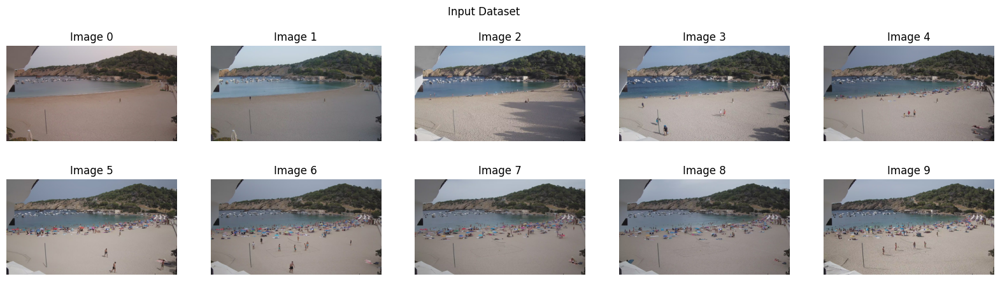

In [2]:
img_path = 'Kibria/'
input_images = [cv2.imread(os.path.join(img_path, img)) for img in os.listdir(img_path) if img.endswith('jpg')]
image_names = [img for img in os.listdir(img_path) if img.endswith('jpg')]
# Visualize images
fig, axs = plt.subplots(2, 5, figsize=(20,5))
# Show one image per subplot
for idx, img in enumerate(input_images):
    axs[idx//5, idx%5].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[idx//5, idx%5].set_title(f'Image {idx}')
    axs[idx//5, idx%5].axis('off')
plt.suptitle("Input Dataset")
plt.show()

In [3]:
annotations_df = pd.read_csv('labels_my-project-name_2022-11-27-03-32-13.csv')
# Cleaning the annotations
annotations_df = annotations_df.drop(annotations_df[annotations_df['bbox_width'] == 0].index)
annotations_df = annotations_df.drop(annotations_df[annotations_df['bbox_height'] == 0].index)
annotations_df['image_id'] = [f'Image {image_names.index(x)}' for x in annotations_df['image_name'].tolist()]
annotations_df.head()

,label_name,bbox_x,bbox_y,bbox_width,bbox_height,image_name,image_width,image_height,image_id
0,person,1501,453,29,34,1660366800.jpg,1920,1080,Image 0
1,person,419,564,43,63,1660370400.jpg,1920,1080,Image 1
2,person,1232,609,36,43,1660374000.jpg,1920,1080,Image 2
3,person,788,516,43,57,1660374000.jpg,1920,1080,Image 2
4,person,417,541,27,45,1660374000.jpg,1920,1080,Image 2


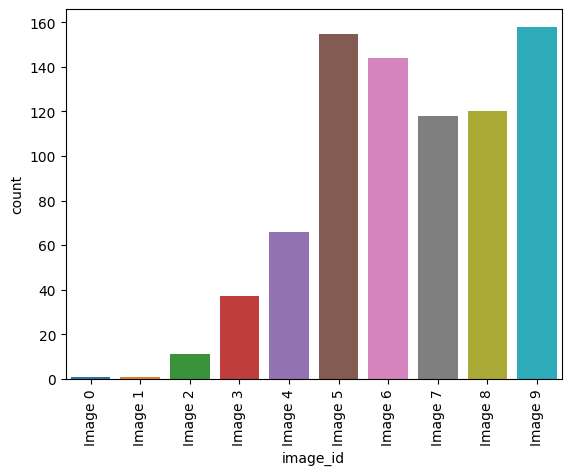

In [4]:
sns.countplot(data=annotations_df, x = 'image_id')
plt.xticks(rotation=90)
plt.show()

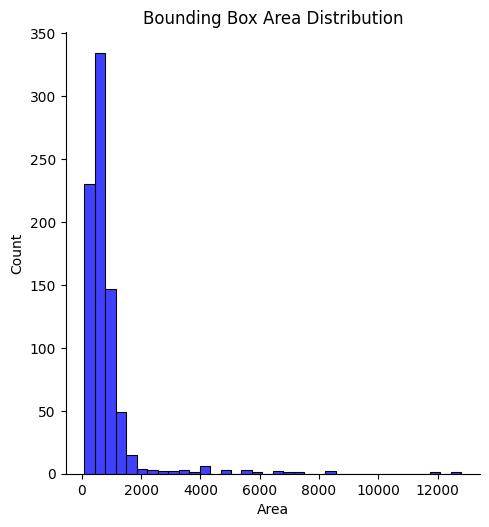

In [5]:
sns.displot(annotations_df['bbox_height'] * annotations_df['bbox_width'], kde=False, 
             bins=int(180/5), color = 'blue')
plt.xlabel("Area")
plt.title("Bounding Box Area Distribution")
plt.show()

In [6]:
box_stats = pd.DataFrame(zip(annotations_df['bbox_height'] * annotations_df['bbox_width'], annotations_df['bbox_width'] / annotations_df['bbox_height']), columns=['Area', 'Aspect Ratio'])
box_stats.describe()

,Area,Aspect Ratio
count,811.000000,811.000000
mean,825.832306,0.835255
std,1049.398048,0.499664
min,90.000000,0.157895
25%,414.000000,0.516539
50%,600.000000,0.703704
75%,868.500000,1.000000
max,12792.000000,3.538462


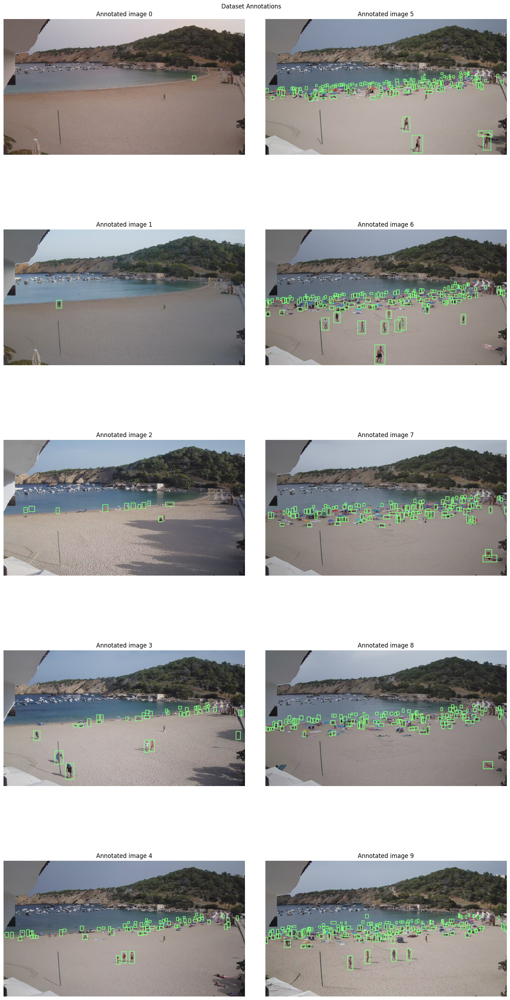

In [7]:
img_path = 'Kibria/'
input_images = [cv2.imread(os.path.join(img_path, img)) for img in os.listdir(img_path) if img.endswith('jpg')]
image_names = [img for img in os.listdir(img_path) if img.endswith('jpg')]
# Visualize images
fig, axs = plt.subplots(5, 2, figsize=(15,30))
fig.tight_layout()
# Show one image per subplot
for idx, img in enumerate(input_images):
    df = annotations_df[annotations_df['image_name'] == image_names[idx]]
    temp = img.copy()
    for _, row in df.iterrows():
        x_min = row['bbox_x']
        y_min = row['bbox_y']
        x_max = x_min + row['bbox_width']
        y_max = y_min + row['bbox_height']
        temp = cv2.rectangle(temp, (x_min, y_min), (x_max, y_max), (127, 255, 127), 3)
    axs[idx%5, idx//5].imshow(cv2.cvtColor(temp, cv2.COLOR_BGR2RGB))
    axs[idx%5, idx//5].set_title(f'Annotated image {idx}')
    axs[idx%5, idx//5].axis('off')
plt.suptitle("Dataset Annotations")
plt.show()

# Dual Belieif Masking Algorithm

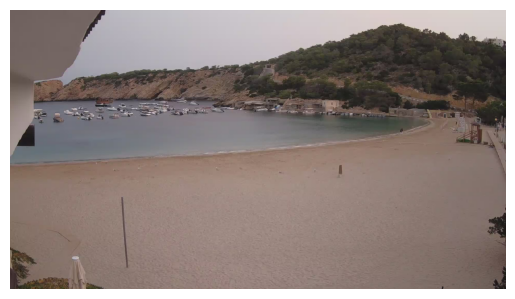

In [8]:
empty_beach = input_images[0]
display_image(empty_beach)

In [9]:
minBox = 300
maxBox = 3000
minRatio = 0.2
maxRatio = 2.5
cutoff = 450

### Applying the algorithm on each image from the dataset

In [11]:
predictions_df = pd.DataFrame(columns=['image_id', 'bbox_x', 'bbox_y', 'bbox_width', 'bbox_height', 'area', 'aspect_ratio'])
points = []
boxes_array = []
output_images = []
show_img = False # Disabled to compress size for GitHub, set this to True to visualize locally
# better accuracy with alpha 0.65, thresh 44, morph False
for idx, img in enumerate(input_images[1:]):
    avg_img = get_average_image(img, empty_beach, alpha = 0.65)
    bel1 = colorspace_distance_mask(img, empty_beach, thresh = 35, morph = True, show=show_img)
    bel2 = get_canny_edges(img, empty_beach, show=show_img)
    mask = cv2.bitwise_or(bel1, bel2)
    mask = cv2.erode(mask, np.ones((3,3)))
    boxes,p,i = get_bboxes_and_points(img, mask, cutoff,  minBox, maxBox, minRatio, maxRatio, draw_boxes = show_img, return_image=True)
    for b in boxes:
        predictions_df.loc[-1] = [f'Image {idx + 1}', b[0], b[1], b[2], b[3], b[2]*b[3], b[3]/b[2]]
        predictions_df.index = predictions_df.index + 1  # shifting index
        predictions_df = predictions_df.sort_index()
    output_images.append(i)
    boxes_array.append(boxes) # keep the boxes for IoU calculation
    points.append(p)          # preserve the points to be used during validation

In [12]:
predictions_df.head()

,image_id,bbox_x,bbox_y,bbox_width,bbox_height,area,aspect_ratio
0,Image 9,1544,451,31,14,434,0.451613
1,Image 9,1307,479,42,28,1176,0.666667
2,Image 9,1522,480,56,30,1680,0.535714
3,Image 9,1449,485,34,15,510,0.441176
4,Image 9,1124,493,21,26,546,1.238095


# Evaluation
## Image-level


In [13]:
eval_df = pd.DataFrame(predictions_df['image_id'].value_counts(), columns = ['image_id'])
eval_df = eval_df.join(pd.DataFrame(annotations_df['image_id'].value_counts(), columns = ['image_id']), rsuffix='_gt')
eval_df = eval_df.rename(columns={'image_id': 'people', 'image_id_gt': 'people_gt'})
eval_df = eval_df.sort_index()
eval_df['mse'] = np.power(eval_df['people'] - eval_df['people_gt'], 2)
eval_df['error_pct'] = np.divide(eval_df['people'], eval_df['people_gt']) * 100

In [14]:
eval_df

,people,people_gt,mse,error_pct
Image 1,5,1,16,500.000000
Image 2,54,11,1849,490.909091
Image 3,36,37,1,97.297297
Image 4,34,66,1024,51.515152
Image 5,34,155,14641,21.935484
Image 6,43,144,10201,29.861111
Image 7,49,118,4761,41.525424
Image 8,43,120,5929,35.833333
Image 9,88,158,4900,55.696203


In [15]:
print(f"Mean MSE: {eval_df['mse'].mean()}")

Mean MSE: 4813.555555555556


# Person-level

In [16]:
tp = {}
fn = {}
fp = {}
iou = {}
gt_v_pred = [empty_beach]
fp_flag = 0
for x, img in enumerate(annotations_df['image_id'].unique()):
    if x == 0:
        continue
    out = input_images[x].copy()
    df = annotations_df[annotations_df['image_id']==img]
    for p in points[x-1]:
        for _, b in df.iterrows():
            fp_flag = 0
            # checking whether the points falls inside a ground-truth bounding box
            if b['bbox_x']<=p[0]<=(b['bbox_x']+b['bbox_width']) and b['bbox_y']<=p[1]<=(b['bbox_y']+b['bbox_height']):
                boxA = [b['bbox_x'], b['bbox_y'], b['bbox_x']+b['bbox_width'], b['bbox_y']+b['bbox_height']]
                pred_box = boxes_array[x-1][points[x-1].index(p)]
                boxB = [pred_box[0], pred_box[1], pred_box[0]+pred_box[2], pred_box[1]+pred_box[3]]
                if not img in tp:
                    tp[img] = 0
                if not img in iou:
                    iou[img] = 0
                tp[img] += 1
                iou[img] += bb_intersection_over_union(boxA, boxB)
                cv2.rectangle(out, (b['bbox_x'], b['bbox_y']), ((b['bbox_x']+b['bbox_width']), (b['bbox_y']+b['bbox_height'])), (127, 255, 25), 3)
                cv2.circle(out, p, 5, (0,0,255), -1)
                fp_flag = 1
                break

        if fp_flag == 0:
            if not img in fp:
              fp[img] = 0
            fp[img] += 1

    gt_v_pred.append(out)

    fn[img] = df.shape[0] - len(points[x-1]) if len(points[x-1]) < df.shape[0] else 0
        


In [17]:
acc_score=pd.DataFrame([tp, fp, fn, iou]).T
acc_score = acc_score.rename(columns={0: 'tp', 1: 'fp', 2: 'fn', 3: 'iou'})
acc_score['precision'] = acc_score['tp'] / (acc_score['tp']+acc_score['fp'])
acc_score['recall'] = acc_score['tp'] / (acc_score['tp']+acc_score['fn'])
acc_score['iou'] = acc_score['iou']/acc_score['tp']

In [18]:
acc_score

,tp,fp,fn,iou,precision,recall
Image 1,1.0,4.0,0.0,0.230114,0.200000,1.000000
Image 2,3.0,51.0,0.0,0.404343,0.055556,1.000000
Image 3,11.0,25.0,1.0,0.369141,0.305556,0.916667
Image 4,13.0,21.0,32.0,0.403276,0.382353,0.288889
Image 5,16.0,18.0,121.0,0.352940,0.470588,0.116788
Image 6,20.0,23.0,101.0,0.356686,0.465116,0.165289
Image 7,31.0,18.0,69.0,0.341086,0.632653,0.310000
Image 8,24.0,19.0,77.0,0.386157,0.558140,0.237624
Image 9,25.0,63.0,70.0,0.425395,0.284091,0.263158


In [19]:
print(f"Average precision:{acc_score['precision'].mean()*100:<6.2f}%\n\
Average recall:{acc_score['recall'].mean()*100:<6.2f}%\n\
Average IoU:{acc_score['iou'].mean()*100:<6.2f}%\n\
Total true-positives:{acc_score['tp'].sum():<6.0f}")

Average precision:37.27 %
Average recall:47.76 %
Average IoU:36.32 %
Total true-positives:144   


Note: Visualization cleared for GitHub

In [ ]:
# Visualize images
fig, axs = plt.subplots(5, 2, figsize=(15,30))
fig.tight_layout()
# Show one image per subplot
for idx, img in enumerate(gt_v_pred):
    axs[idx%5, idx//5].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    if idx == 0:    
        axs[idx%5, idx//5].set_title(f'Empty Beach')
    else:
        axs[idx%5, idx//5].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[idx%5, idx//5].set_title(f'Correct predictions for image {idx}')
    axs[idx%5, idx//5].axis('off')
plt.suptitle("Ground-truth vs Predictions")
plt.show()

# Comparing to SOTA Deep Learning

In [22]:
import torch
model = torch.hub.load('ultralytics/yolov5', 'yolov5m', pretrained=True)
model.conf = 0.25
model.classes = [0]
model.iou = 0.2

Using cache found in /home/rkibria/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-11-12 Python-3.8.10 torch-1.12.1+cu102 CPU

Fusing layers... 
YOLOv5m summary: 290 layers, 21172173 parameters, 0 gradients
Adding AutoShape... 


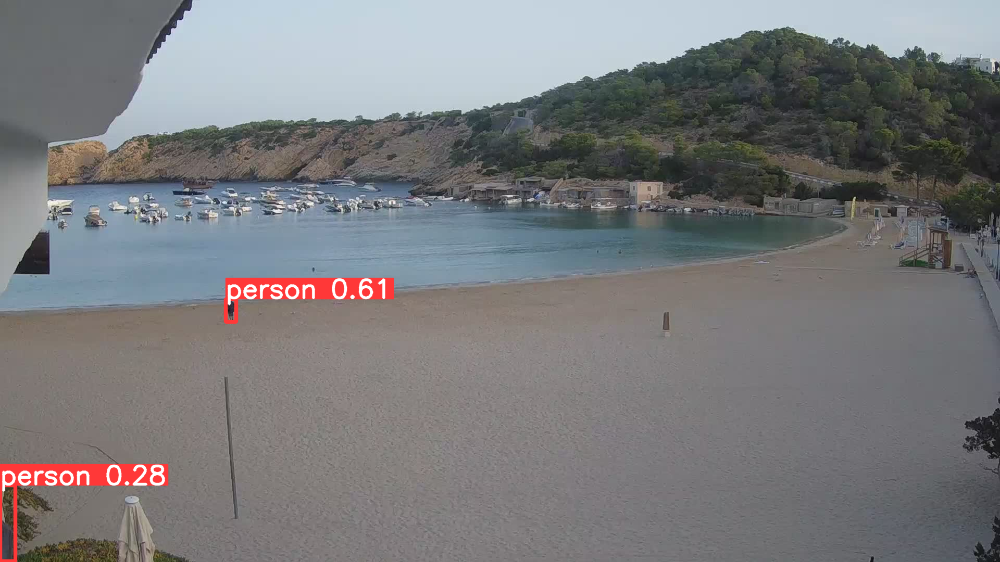

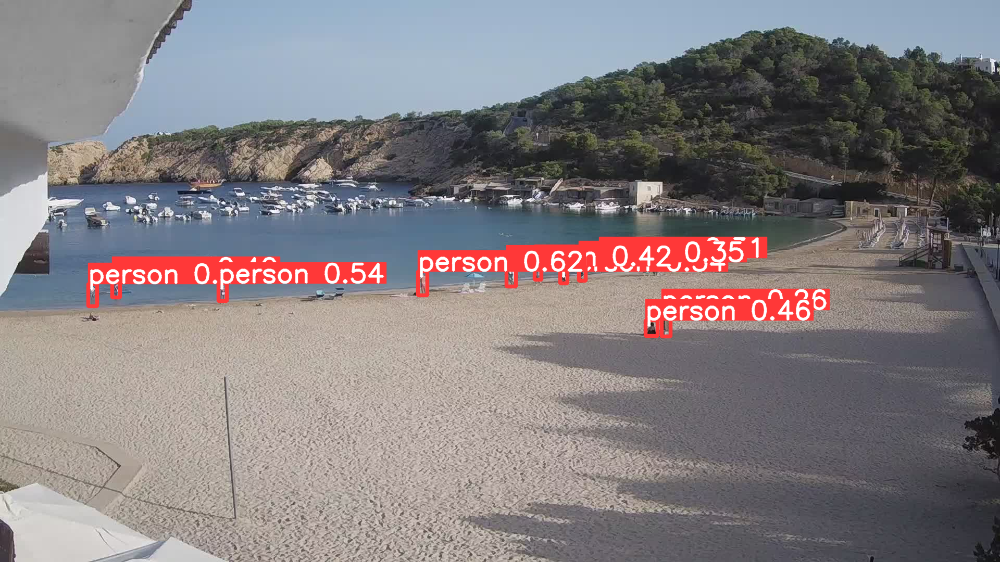

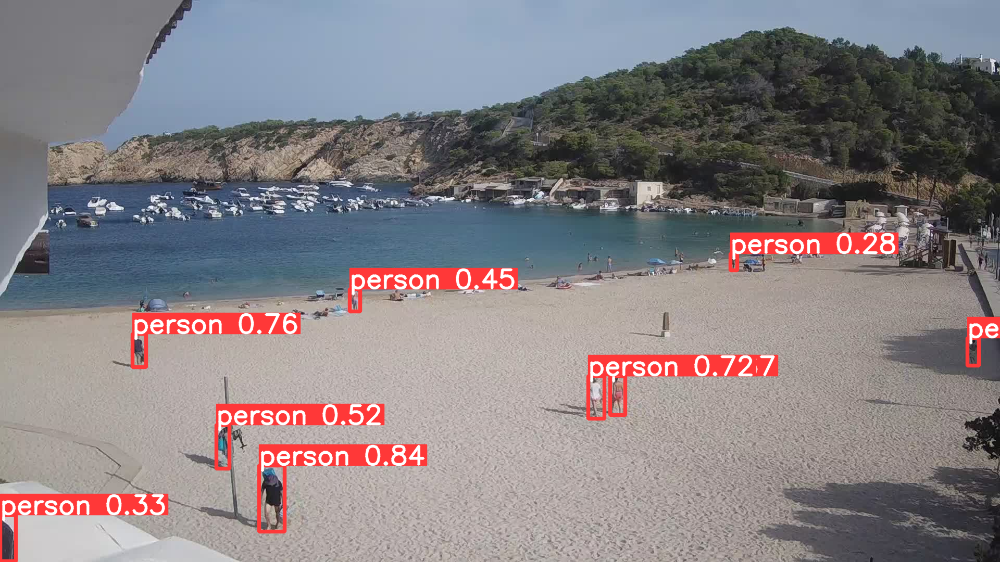

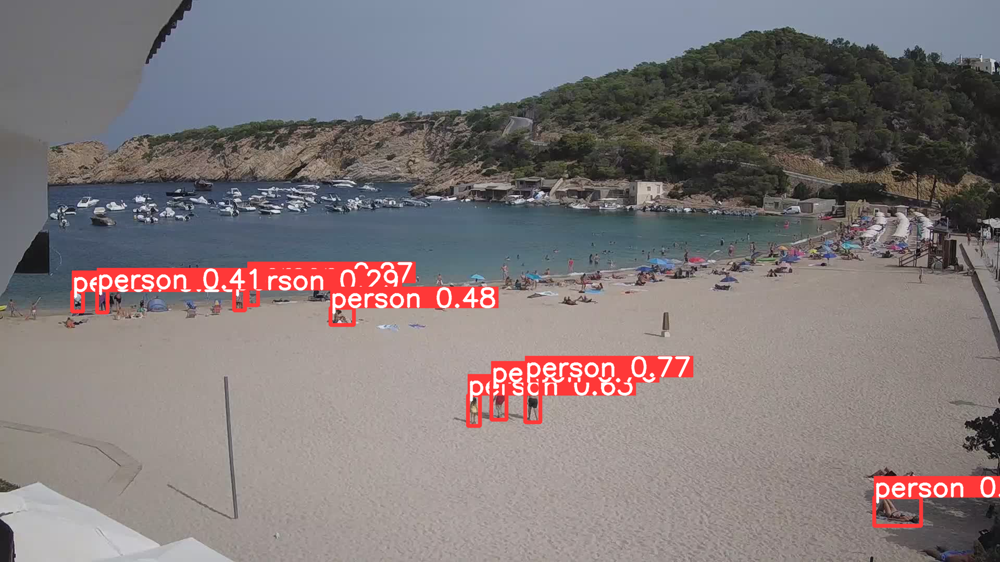

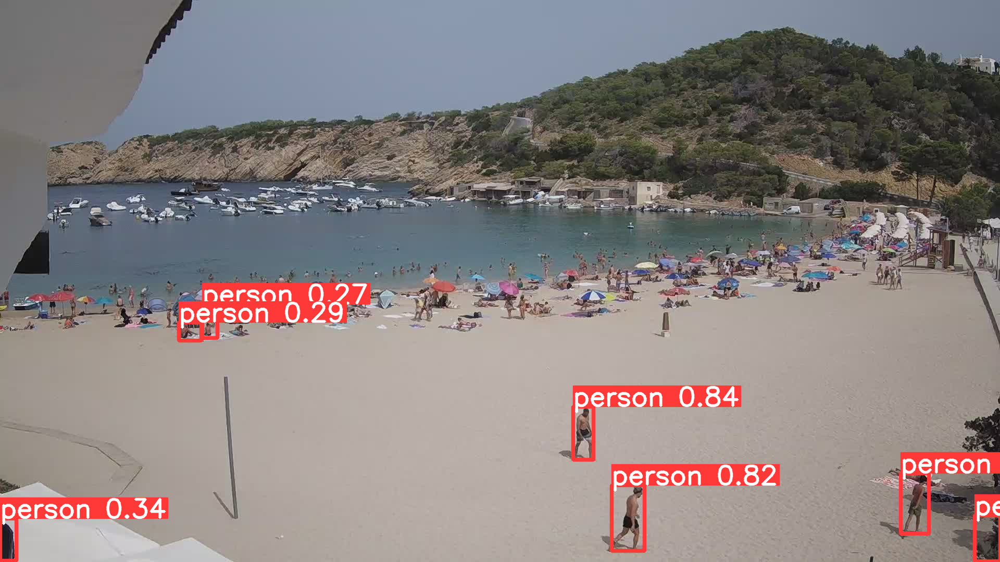

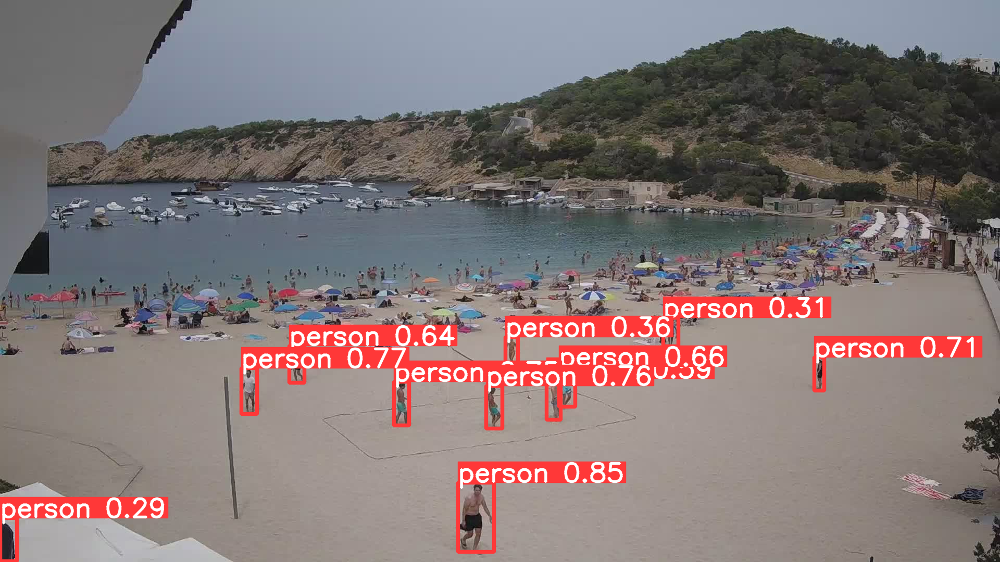

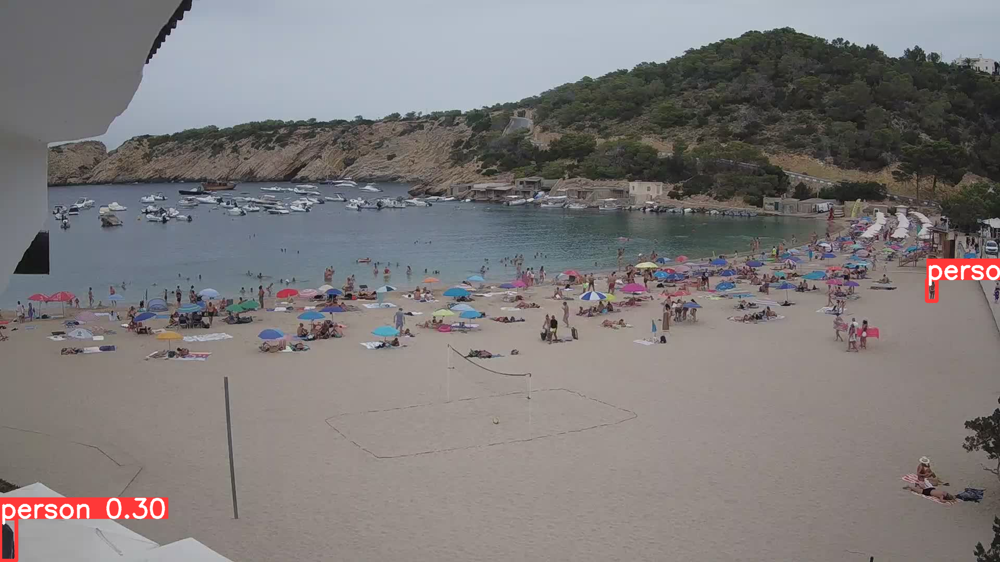

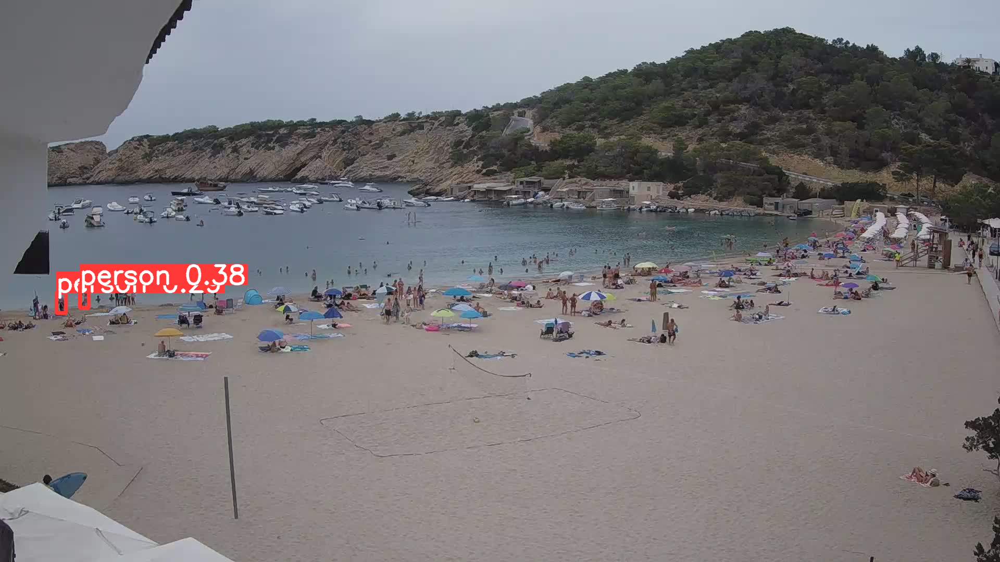

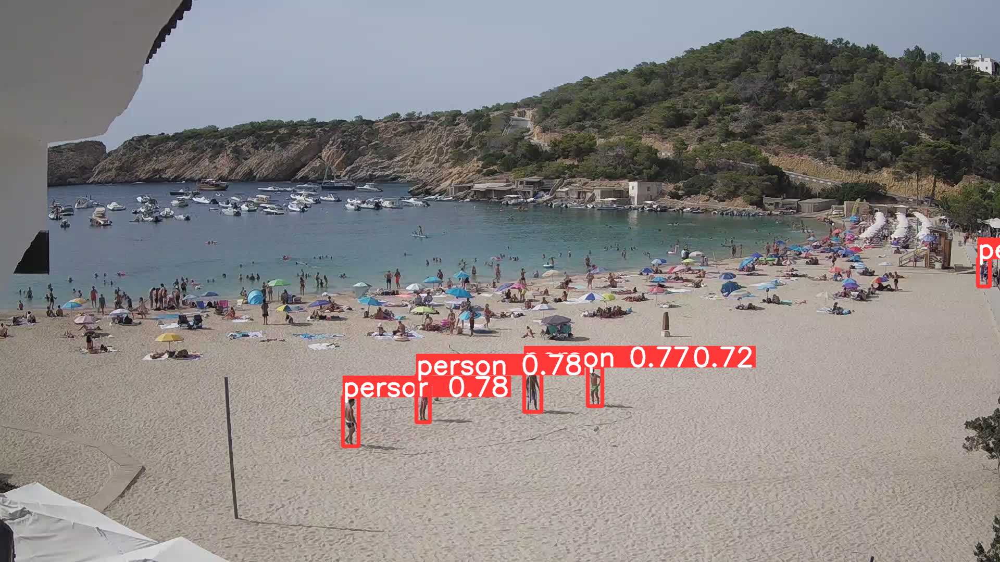

In [23]:
input_images = [cv2.imread(os.path.join(img_path, img)) for img in os.listdir(img_path) if img.endswith('jpg')]
yolo_preds = []
image_names = [img for img in os.listdir(img_path) if img.endswith('jpg')]
# Visualize images
fig, axs = plt.subplots(5, 2, figsize=(15,30))
fig.tight_layout()
# Show one image per subplot
for idx, img in enumerate(input_images):
    if idx == 0:
        continue
    img_yolo = img.copy()
    img_yolo = cv2.cvtColor(img_yolo, cv2.COLOR_BGR2RGB)
    results = model(img_yolo)
    results.show()
    yolo_df = results.pandas().xyxy[0]
    yolo_preds.append(yolo_df.shape[0])

In [24]:
eval_df['yolo'] = yolo_preds
eval_df['yolo_mse'] = np.power(eval_df['yolo'] - eval_df['people_gt'], 2)

In [25]:
eval_df

,people,people_gt,mse,error_pct,yolo,yolo_mse
Image 1,5,1,16,500.000000,2,1
Image 2,54,11,1849,490.909091,11,0
Image 3,36,37,1,97.297297,9,784
Image 4,34,66,1024,51.515152,9,3249
Image 5,34,155,14641,21.935484,7,21904
Image 6,43,144,10201,29.861111,11,17689
Image 7,49,118,4761,41.525424,2,13456
Image 8,43,120,5929,35.833333,2,13924
Image 9,88,158,4900,55.696203,5,23409


In [26]:
print(f"Mean MSE: {eval_df['yolo_mse'].mean()}")

Mean MSE: 10490.666666666666
